In [ ]:
#Based on
#https://blog.roboflow.com/retail-store-item-detection-using-yolov5/

# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.

### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train YOLOv5](https://blog.roboflow.ai/how-to-train-yolov5-on-a-custom-dataset/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train YOLOv5 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install YOLOv5 dependencies
* Download custom YOLOv5 object detection data
* Write our YOLOv5 Training configuration
* Run YOLOv5 training
* Evaluate YOLOv5 performance
* Visualize YOLOv5 training data
* Run YOLOv5 inference on test images
* Export saved YOLOv5 weights for future inference



### **About**

[Roboflow](https://roboflow.com) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

**Looking for a vision model available via API without hassle? Try Roboflow Train.**

![Roboflow Wordmark](https://i.imgur.com/dcLNMhV.png)



#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [ ]:


!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -r yolov5/requirements.txt  # install dependencies
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
#from utils.google_utils import gdrive_download  # to download models/datasets
idx = 0
clear_output()
#print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))



# Download Correctly Formatted Custom Dataset 

We'll download our dataset from Roboflow. Use the "**YOLOv5 PyTorch**" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

To get your data into Roboflow, follow the [Getting Started Guide](https://blog.roboflow.ai/getting-started-with-roboflow/).



![YOLOv5 PyTorch export](https://i.imgur.com/5vr9G2u.png)


In [ ]:
%cd /content
!curl -L "https://app.roboflow.ai/ds/dNpgZfRlr4?key=cteun9wN2k" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    68  100    68    0     0     72      0 --:--:-- --:--:-- --:--:--    72
100   896  100   896    0     0    366      0  0:00:02  0:00:02 --:--:--  3234
100 53.8M  100 53.8M    0     0  16.5M      0  0:00:03  0:00:03 --:--:--  166M
Archive:  roboflow.zip
 extracting: test/images/train_752_jpg.rf.0e684141335f0c59d001064f8afd9e86.jpg  
 extracting: test/images/train_342_jpg.rf.0921748112ab93f5ceebe90b6ad00f71.jpg  
 extracting: test/images/train_736_jpg.rf.0fe424bb53c9d26d89da0fb133d338be.jpg  
 extracting: test/images/train_232_jpg.rf.1f891713a9f440e14ad9c347bc5aec62.jpg  
 extracting: test/images/train_135_jpg.rf.26eab4f674810b2d76100740f48c3103.jpg  
 extracting: test/images/train_406_jpg.rf.1f127947f5f19a5e421182eaa2bfaae3.jpg  
 extracting: test/images/train_783_jpg.rf.0c017b7de1582d5e10742bd17feb0c24.jpg  
 extra

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

cat: data.yaml: No such file or directory


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

FileNotFoundError: ignored

In [ ]:

%cd /content/
##write custom model .yaml
#you can configure this based on other YOLOv5 models in the models directory

with open('yolov5/models/custom_yolov5s.yaml', 'w') as f:
  # parameters
  f.write('nc: ' + num_classes + '\n')
  #f.write('nc: ' + str(len(class_labels)) + '\n')
  f.write('depth_multiple: 0.33'  + '\n') # model depth multiple
  f.write('width_multiple: 0.50'  + '\n')  # layer channel multiple
  f.write('\n')
  f.write('anchors:' + '\n')
  f.write('  - [10,13, 16,30, 33,23] ' + '\n')
  f.write('  - [30,61, 62,45, 59,119]' + '\n')
  f.write('  - [116,90, 156,198, 373,326] ' + '\n')
  f.write('\n')

  f.write('backbone:' + '\n')
  f.write('  [[-1, 1, Focus, [64, 3]],' + '\n')
  f.write('   [-1, 1, Conv, [128, 3, 2]],' + '\n')
  f.write('   [-1, 3, Bottleneck, [128]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 3, 2]],' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [256]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 3, 2]], ' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [512]],' + '\n')
  f.write('   [-1, 1, Conv, [1024, 3, 2]],' + '\n')
  f.write('   [-1, 1, SPP, [1024, [5, 9, 13]]],' + '\n')
  f.write('   [-1, 6, BottleneckCSP, [1024]],' + '\n')
  f.write('  ]' + '\n')
  f.write('\n')

  f.write('head:'  + '\n')
  f.write('  [[-1, 3, BottleneckCSP, [1024, False]],'  + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  
  f.write('   [[-1, 6], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [512, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  f.write('   [[-1, 4], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [256, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('\n' )
  f.write('   [[], 1, Detect, [nc, anchors]],' + '\n')
  f.write('  ]' + '\n')

print('custom model config written!')



/content
custom model config written!


In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/custom_yolov5s.yaml

nc: 1
depth_multiple: 0.33
width_multiple: 0.50

anchors:
  - [10,13, 16,30, 33,23] 
  - [30,61, 62,45, 59,119]
  - [116,90, 156,198, 373,326] 

backbone:
  [[-1, 1, Focus, [64, 3]],
   [-1, 1, Conv, [128, 3, 2]],
   [-1, 3, Bottleneck, [128]],
   [-1, 1, Conv, [256, 3, 2]],
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]], 
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 6, BottleneckCSP, [1024]],
  ]

head:
  [[-1, 3, BottleneckCSP, [1024, False]],
   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],
   [-2, 1, nn.Upsample, [None, 2, "nearest"]],
   [[-1, 6], 1, Concat, [1]],
   [-1, 1, Conv, [512, 1, 1]],
   [-1, 3, BottleneckCSP, [512, False]],
   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],
   [-2, 1, nn.Upsample, [None, 2, "nearest"]],
   [[-1, 4], 1, Concat, [1]],
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 3, BottleneckCSP, [256, False]],
   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],

   [[], 1, Detect, [n

In [ ]:
def write_file(filename,data):
  f = open(filename,"w")
  for line in data:
    f.write(line+"\n")
  f.close()



write_file('/content/data.yaml',['train: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/train/images','val: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/valid/images',"test: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/images",'nc: 1',"names: ['object']"])

#write_file('/content/data.yaml',['train: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512/train/images','val: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/valid/images',"test: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/images",'nc: 1',"names: ['object']"])

#write_file('/content/data.yaml',['train: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/train/images','val: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/valid/images',"test: /content/drive/MyDrive/Tesis/testImages/Productos_512x512/images",'nc: 1',"names: ['object']"])

#write_file('/content/data.yaml',['train: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/train/images','val: /content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/valid/images',"test: /content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/images",'nc: 1',"names: ['object']"])


In [ ]:


# train yolov5s on custom data for 300 epochs
# time its performance, 6 gb con batch
%%time
%cd /content/yolov5/
!python train.py --img 512 --batch 16 --epochs 300 --data '../data.yaml' --cfg ./models/yolov5s.yaml --weights ''  --name yolov5s_results --optimizer 'SGD' --cache



/content/yolov5
train: weights=, cfg=./models/yolov5s.yaml, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=512, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-132-g014acde torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

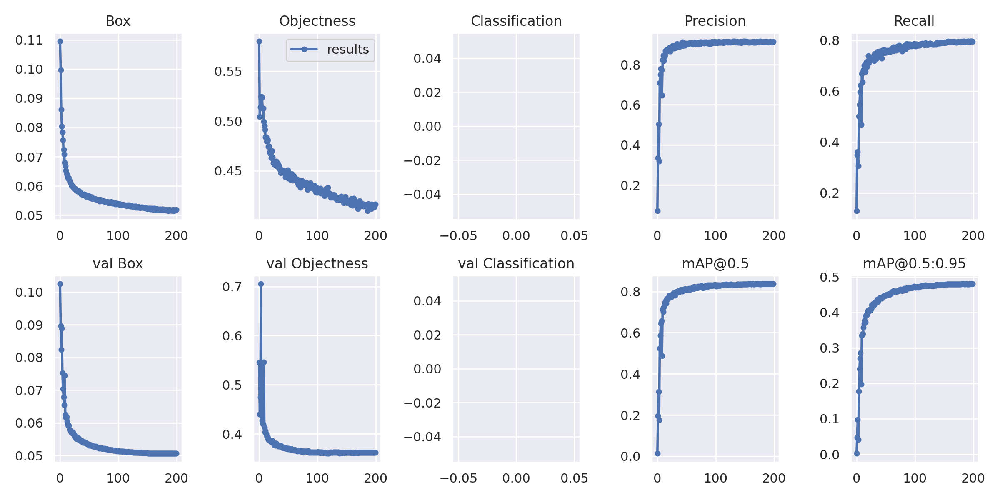

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)  # view results.png

GROUND TRUTH AUGMENTED TRAINING DATA:


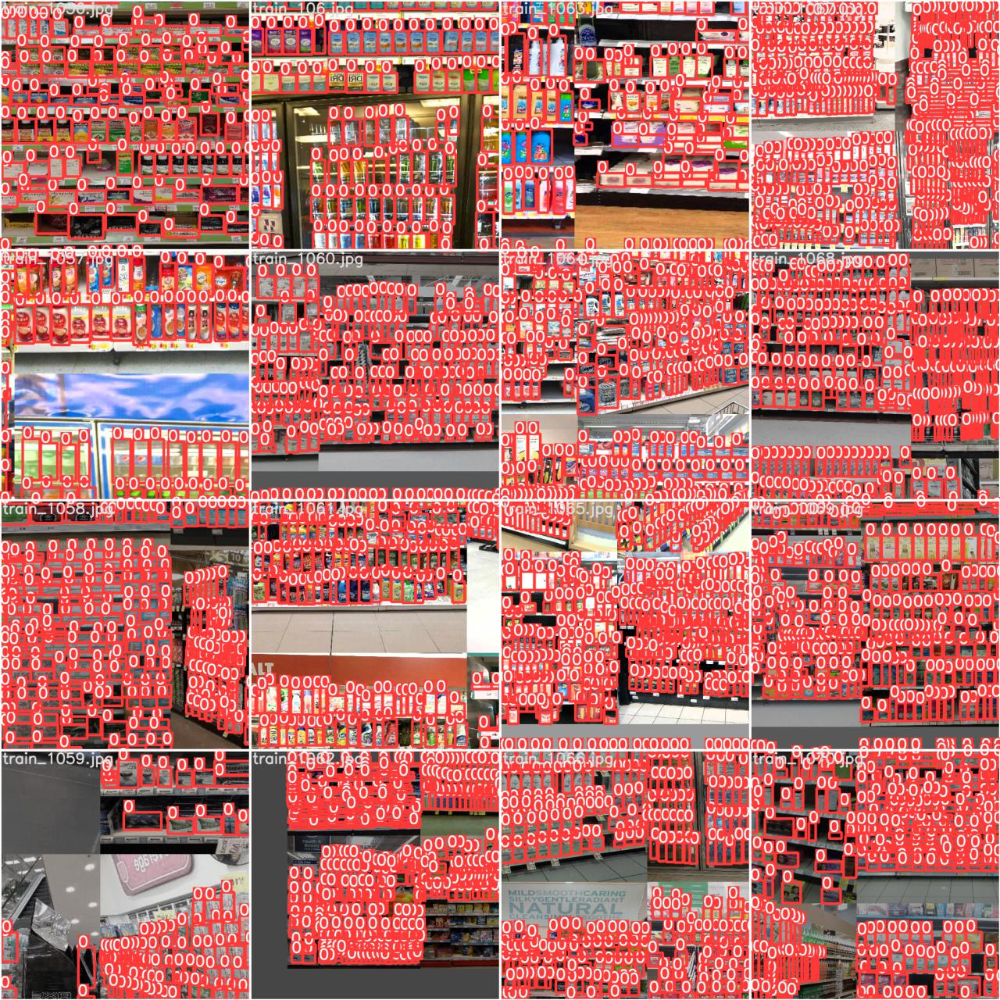

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/train_batch2.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results2/weights

last.pt


In [ ]:
%%time
%cd /content/yolov5/
!python detect.py --weights /content/drive/MyDrive/Tesis/objectDetectionWeights/YOLOv5/last.pt --img 512 --conf 0.6 --source /content/drive/MyDrive/Tesis/testImages/images --save-txt --save-conf



/content/yolov5
detect: weights=['/content/drive/MyDrive/Tesis/objectDetectionWeights/YOLOv5/Tuning/6/best.pt'], source=/content/drive/MyDrive/Tesis/testImages/images, imgsz=[512, 512], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-13-gfc36064 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

^C
CPU times: user 74.3 ms, sys: 18.5 ms, total: 92.9 ms
Wall time: 12.2 s


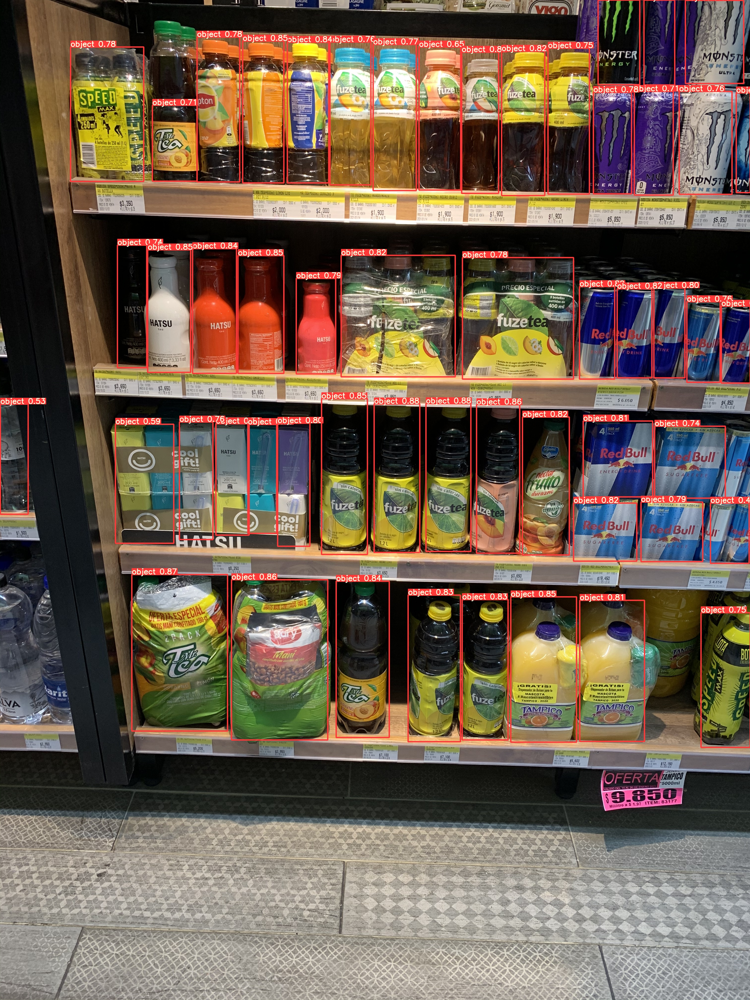

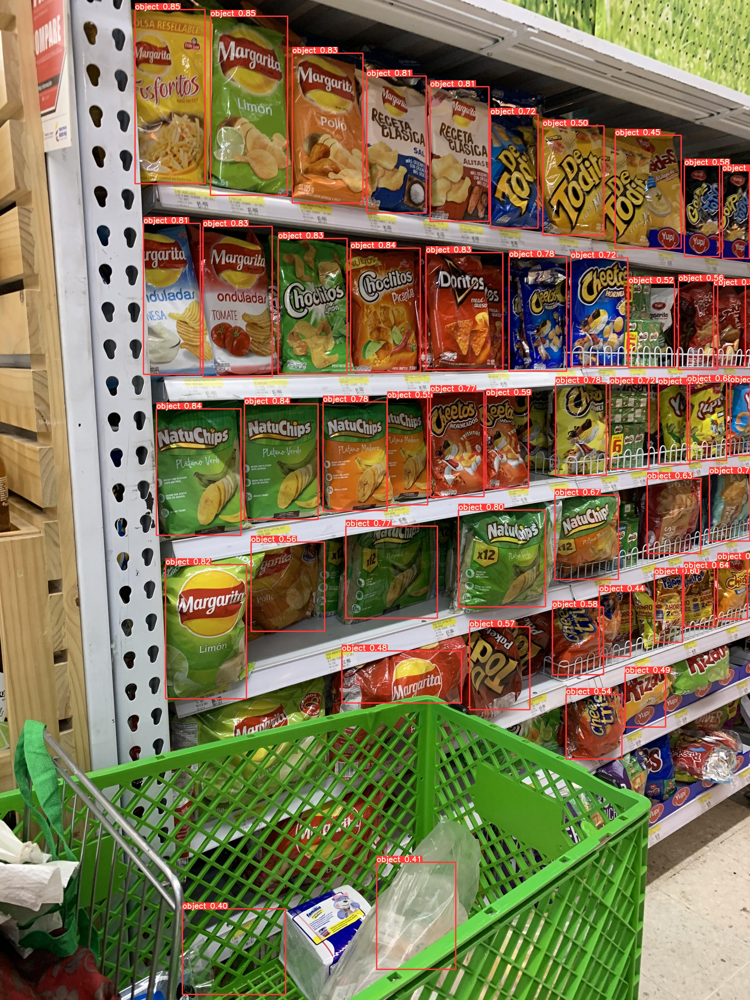

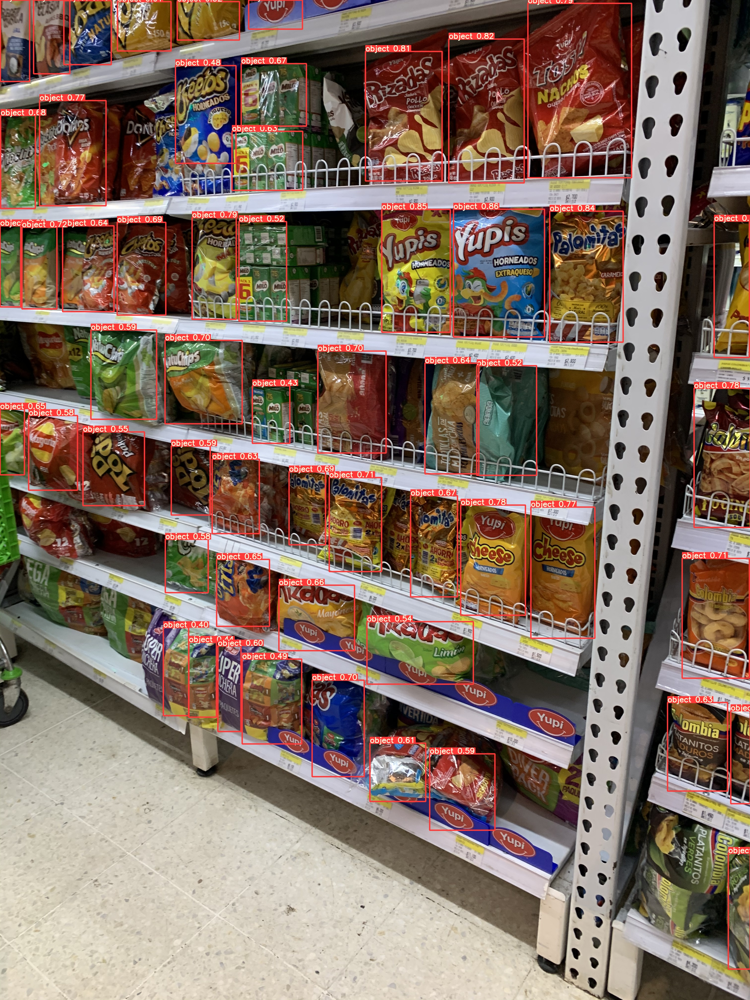

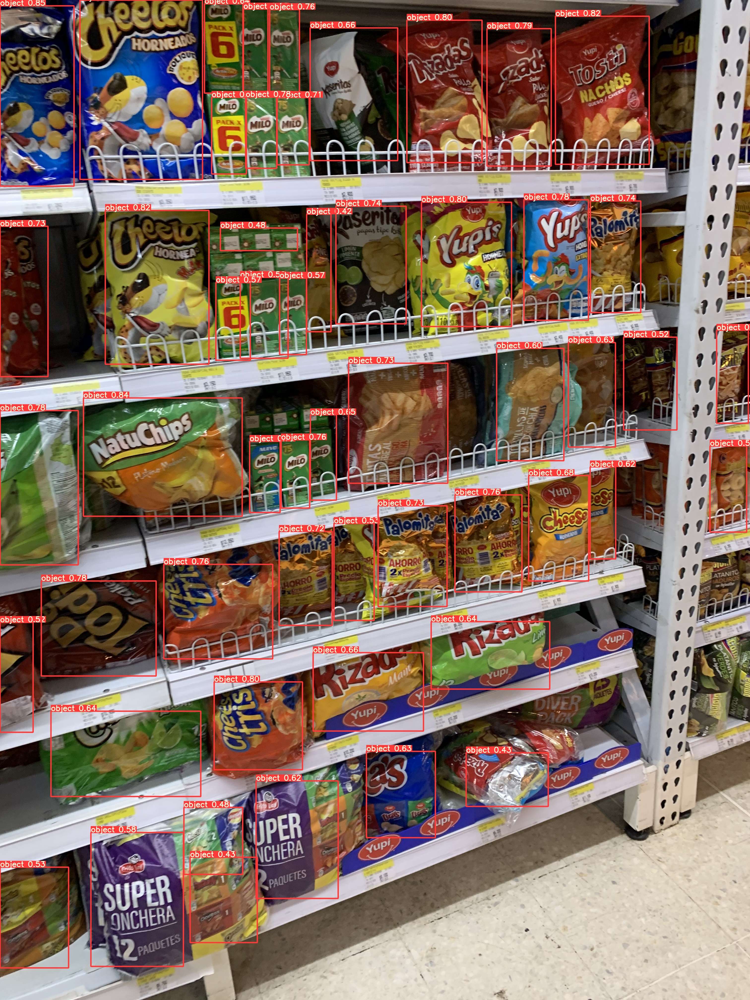

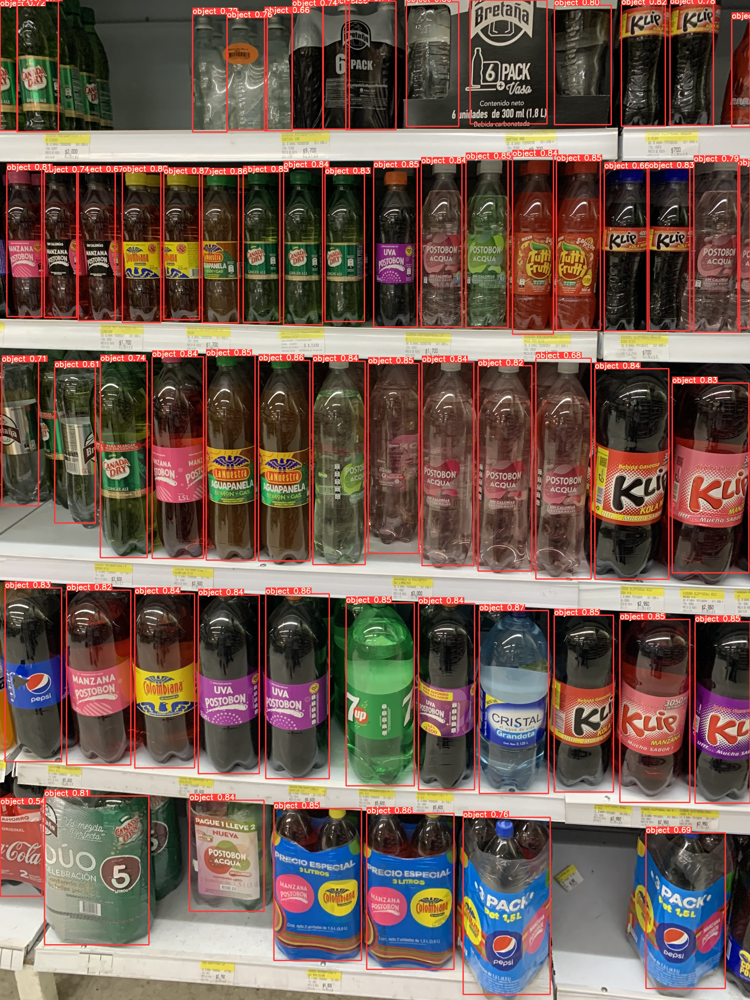

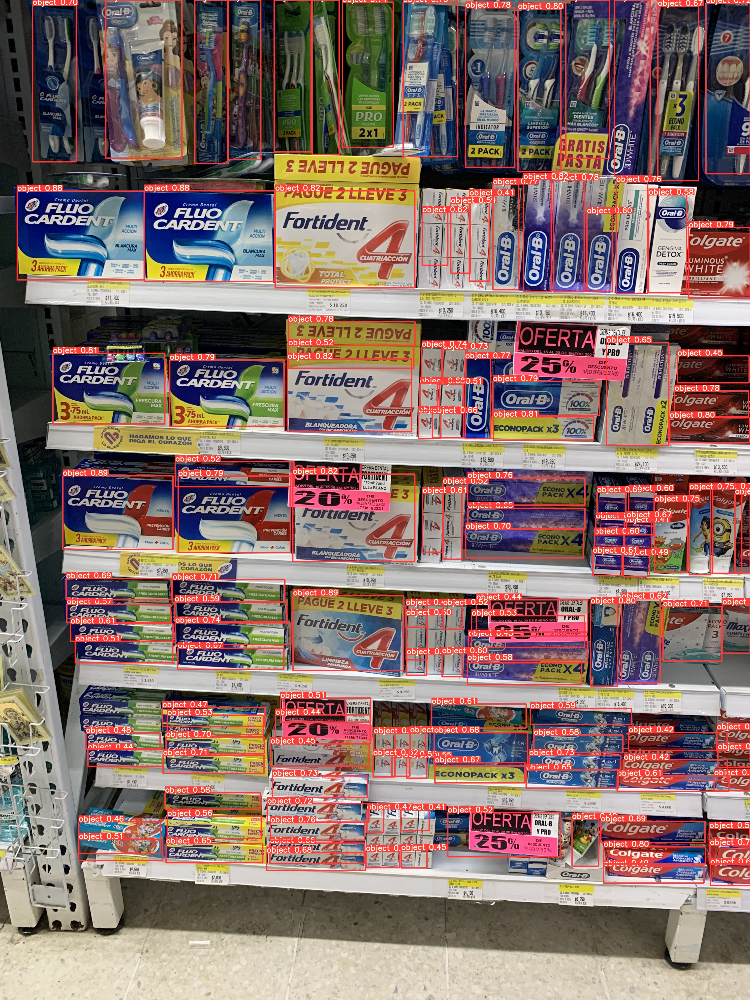

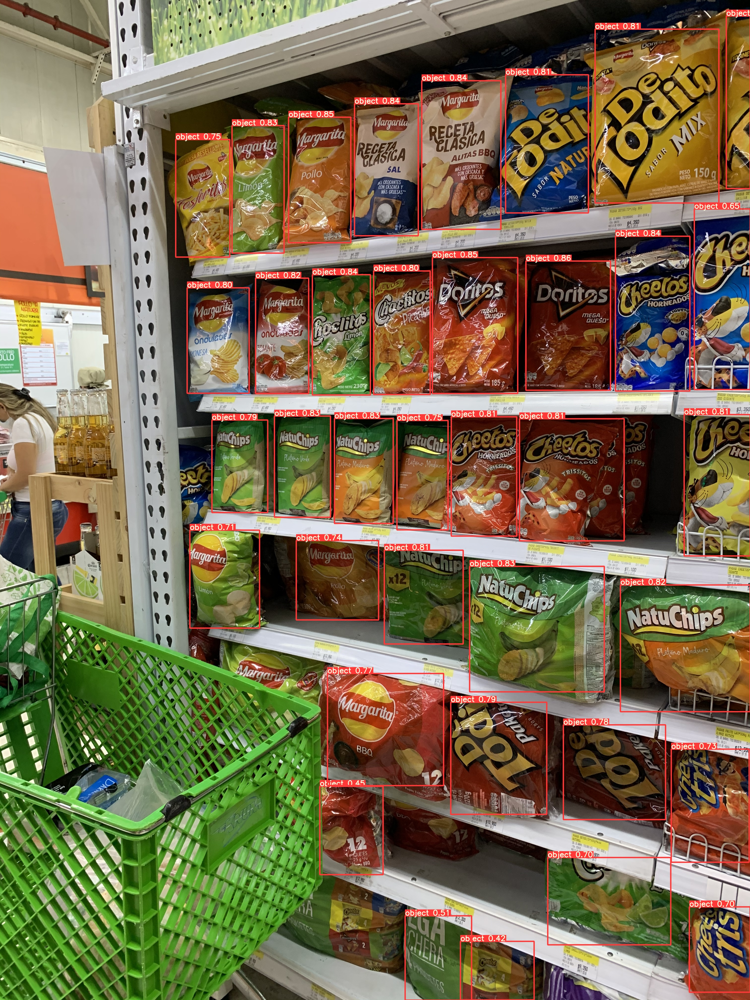

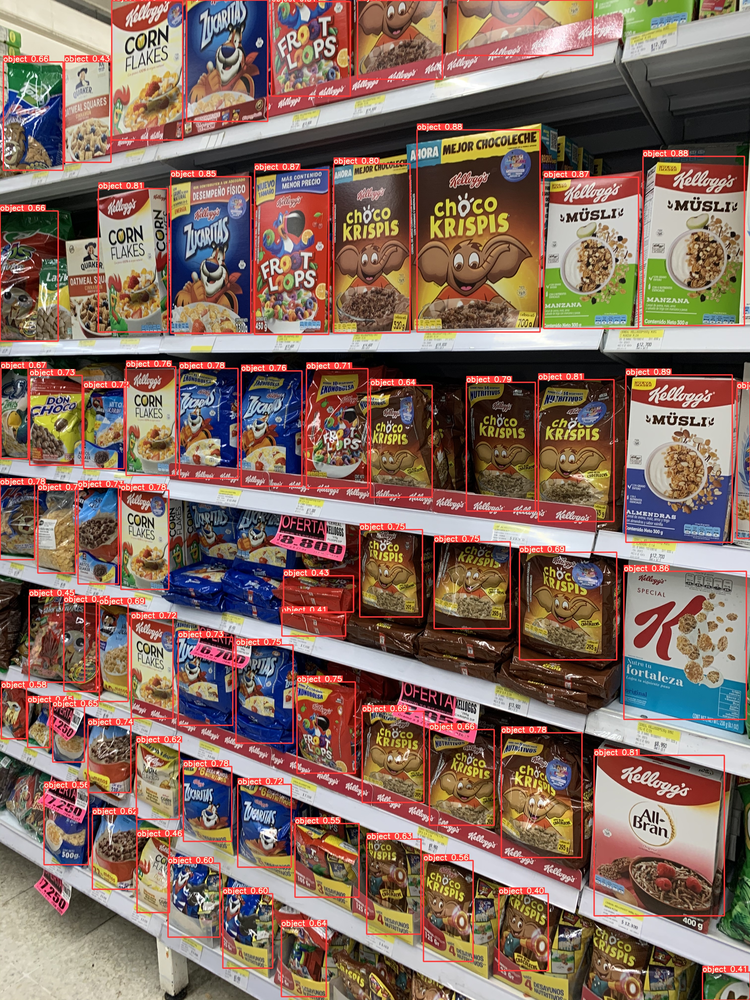



Buffered data was truncated after reaching the output size limit.

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    
    display(Image(filename=imageName))
    print("\n")
idx += 1

# Test model

In [ ]:
%cd /content/yolov5/
!python val.py --img-size 512 --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --data '/content/data.yaml' --task test --save-txt --save-conf

/content/yolov5
val: data=/content/data.yaml, weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], batch_size=32, imgsz=512, conf_thres=0.001, iou_thres=0.6, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=True, save_hybrid=False, save_conf=True, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-132-g014acde torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/labels.cache' images and labels... 1468 found, 0 missing, 0 empty, 0 corrupt: 100% 1468/1468 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95:   2% 1/46 [00:16<12:29, 16.66s/it]WARNING: NMS time limit 1.060s exceeded
               Class     Images     Labels          P          R     mAP@.5 m

In [ ]:

def read_images_IQA(filename):
  f,ans = open(filename,"r"),list()
  for line in f:
    ans.append(line.strip().split()[1])
  f.close()
  return ans

In [ ]:

import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
from itertools import product
from copy import deepcopy
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline


#https://towardsdatascience.com/evaluating-performance-of-an-object-detection-model-137a349c517b
INF = float('inf')

def convert(x,y,w,h,size):
    dh = dw = size
    l = int((x - w / 2) * dw)
    r = int((x + w / 2) * dw)
    t = int((y - h / 2) * dh)
    b = int((y + h / 2) * dh)
    if l < 0:
        l = 0
    if r > dw - 1:
        r = dw - 1
    if t < 0:
        t = 0
    if b > dh - 1:
        b = dh - 1
    #assert l <= r and t <= b
    return l,t,r,b



def get_boxes(filename):
    ans = []
    f = open(filename,"r")
    for line in f:
        line = line.strip().split(" ")
        ans.append(tuple([float(line[i]) for i in range(1,5)]))
    f.close()
    return ans

def get_confidence(filename):
    ans = []
    f = open(filename,"r")
    for line in f:
        line = line.strip().split(" ")
        ans.append(float(line[5]))
    f.close()
    return ans


def transform(data):
    ans = []
    for x,y,w,h in data:
        x1,y1,x2,y2 = convert(x,y,w,h,512)
        #if( x1 <= x2 and y1 <= y2): 
        ans.append([x1,y1,x2,y2])
    return ans


def drawBox(boxes, image):
    for i in range (0, len(boxes)):
        cv2.rectangle(image,(boxes[i][0],boxes[i][1]),(boxes[i][2],boxes[i][3]),(255, 0, 0),1)
    b,g,r = cv2.split(image)           # get b, g, r
    image = cv2.merge([r,g,b])     # switch it to r, g, b
        
    #cv2.namedWindow('final', cv2.WINDOW_NORMAL)
    cv2_imshow(image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

def get_model_scores(pred_boxes):
    """Creates a dictionary of from model_scores to image ids.
    Args:
        pred_boxes (dict): dict of dicts of 'boxes' and 'scores'
    Returns:
        dict: keys are model_scores and values are image ids (usually filenames)
    """
    model_score={}
    for img_id, val in pred_boxes.items():
        for score in val['scores']:
            if score not in model_score.keys():
                model_score[score]=[img_id]
            else:
                model_score[score].append(img_id)
    return model_score

def calc_iou( gt_bbox, pred_bbox):
    '''
    This function takes the predicted bounding box and ground truth bounding box and 
    return the IoU ratio
    '''
    x_topleft_gt, y_topleft_gt, x_bottomright_gt, y_bottomright_gt= gt_bbox
    x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p= pred_bbox
    
    if (x_topleft_gt > x_bottomright_gt) or (y_topleft_gt> y_bottomright_gt):
        return 0
        #raise AssertionError("Ground Truth Bounding Box is not correct")
    if (x_topleft_p > x_bottomright_p) or (y_topleft_p> y_bottomright_p):
        #print("Predicted Bounding Box is not correct",x_topleft_p, x_bottomright_p,y_topleft_p,y_bottomright_gt)
        return 0
        #raise AssertionError("Predicted Bounding Box is not correct",x_topleft_p, x_bottomright_p,y_topleft_p,y_bottomright_gt)
        
         
    #if the GT bbox and predcited BBox do not overlap then iou=0
    if(x_bottomright_gt< x_topleft_p):
        # If bottom right of x-coordinate  GT  bbox is less than or above the top left of x coordinate of  the predicted BBox
        
        return 0.0
    if(y_bottomright_gt< y_topleft_p):  # If bottom right of y-coordinate  GT  bbox is less than or above the top left of y coordinate of  the predicted BBox
        
        return 0.0
    if(x_topleft_gt> x_bottomright_p): # If bottom right of x-coordinate  GT  bbox is greater than or below the bottom right  of x coordinate of  the predcited BBox
        
        return 0.0
    if(y_topleft_gt> y_bottomright_p): # If bottom right of y-coordinate  GT  bbox is greater than or below the bottom right  of y coordinate of  the predcited BBox
        
        return 0.0
    
    
    GT_bbox_area = (x_bottomright_gt -  x_topleft_gt + 1) * (  y_bottomright_gt -y_topleft_gt + 1)
    Pred_bbox_area =(x_bottomright_p - x_topleft_p + 1 ) * ( y_bottomright_p -y_topleft_p + 1)
    
    x_top_left =np.max([x_topleft_gt, x_topleft_p])
    y_top_left = np.max([y_topleft_gt, y_topleft_p])
    x_bottom_right = np.min([x_bottomright_gt, x_bottomright_p])
    y_bottom_right = np.min([y_bottomright_gt, y_bottomright_p])
    
    intersection_area = (x_bottom_right- x_top_left + 1) * (y_bottom_right-y_top_left  + 1)
    
    union_area = (GT_bbox_area + Pred_bbox_area - intersection_area)
   
    return intersection_area/union_area

def calc_precision_recall(image_results):
    """Calculates precision and recall from the set of images
    Args:
        img_results (dict): dictionary formatted like:
            {
                'img_id1': {'true_pos': int, 'false_pos': int, 'false_neg': int},
                'img_id2': ...
                ...
            }
    Returns:
        tuple: of floats of (precision, recall)
    """
    true_positive=0
    false_positive=0
    false_negative=0
    #precision = 0
    #recall = 0
    for img_id, res in image_results.items():
        true_positive +=res['true_positive']
        false_positive += res['false_positive']
        false_negative += res['false_negative']
        try:
            precision = true_positive/(true_positive+ false_positive)
        except ZeroDivisionError:
            precision= 0.0#precision
        try:
            recall = true_positive/(true_positive + false_negative)
        except ZeroDivisionError:
            recall= 0.0#recall
    return (precision, recall)


def get_single_image_results(gt_boxes, pred_boxes, iou_thr):
    """Calculates number of true_pos, false_pos, false_neg from single batch of boxes.
    Args:
        gt_boxes (list of list of floats): list of locations of ground truth
            objects as [xmin, ymin, xmax, ymax]
        pred_boxes (dict): dict of dicts of 'boxes' (formatted like `gt_boxes`)
            and 'scores'
        iou_thr (float): value of IoU to consider as threshold for a
            true prediction.
    Returns:
        dict: true positives (int), false positives (int), false negatives (int)
    """
    all_pred_indices= range(len(pred_boxes))
    all_gt_indices=range(len(gt_boxes))
    if len(all_pred_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    if len(all_gt_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    
    gt_idx_thr=[]
    pred_idx_thr=[]
    ious=[]
    for ipb, pred_box in enumerate(pred_boxes):
        for igb, gt_box in enumerate(gt_boxes):
            iou= calc_iou(gt_box, pred_box)
            
            if iou >iou_thr:
                gt_idx_thr.append(igb)
                pred_idx_thr.append(ipb)
                ious.append(iou)
    iou_sort = np.argsort(ious)[::1]
    if len(iou_sort)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    else:
        gt_match_idx=[]
        pred_match_idx=[]
        for idx in iou_sort:
            gt_idx=gt_idx_thr[idx]
            pr_idx= pred_idx_thr[idx]
            # If the boxes are unmatched, add them to matches
            if(gt_idx not in gt_match_idx) and (pr_idx not in pred_match_idx):
                gt_match_idx.append(gt_idx)
                pred_match_idx.append(pr_idx)
        tp= len(gt_match_idx)
        fp= len(pred_boxes) - len(pred_match_idx)
        fn = len(gt_boxes) - len(gt_match_idx)
    return {'true_positive': tp, 'false_positive': fp, 'false_negative': fn}

def  get_avg_precision_at_iou(gt_boxes, pred_bb, iou_thr=0.5):
    
    model_scores = get_model_scores(pred_bb)
    sorted_model_scores= sorted(model_scores.keys())# Sort the predicted boxes in descending order (lowest scoring boxes first):
    for img_id in pred_bb.keys():
        
        arg_sort = np.argsort(pred_bb[img_id]['scores'])
        pred_bb[img_id]['scores'] = np.array(pred_bb[img_id]['scores'])[arg_sort].tolist()
        pred_bb[img_id]['boxes'] = np.array(pred_bb[img_id]['boxes'])[arg_sort].tolist()
    pred_boxes_pruned = deepcopy(pred_bb)
        
    
    precisions = []
    recalls = []
    model_thrs = []
    img_results = {}# Loop over model score thresholds and calculate precision, recall
    for ithr, model_score_thr in enumerate(sorted_model_scores[:-1]):
            # On first iteration, define img_results for the first time:
        #print("Model score : ", model_score_thr)
        img_ids = gt_boxes.keys() if ithr == 0 else model_scores[model_score_thr]
        for img_id in img_ids:
            #print("Image {0} processed".format(img_id))
            gt_boxes_img = gt_boxes[img_id]
            box_scores = pred_boxes_pruned[img_id]['scores']
            start_idx = 0
            for score in box_scores:
                if score <= model_score_thr:
                    pred_boxes_pruned[img_id]
                    start_idx += 1
                else:
                    break 
            # Remove boxes, scores of lower than threshold scores:
            pred_boxes_pruned[img_id]['scores']= pred_boxes_pruned[img_id]['scores'][start_idx:]
            pred_boxes_pruned[img_id]['boxes']= pred_boxes_pruned[img_id]['boxes'][start_idx:]# Recalculate image results for this image
            #print(img_id)
            img_results[img_id] = get_single_image_results(gt_boxes_img, pred_boxes_pruned[img_id]['boxes'], iou_thr)# calculate precision and recall
        prec, rec = calc_precision_recall(img_results)
        precisions.append(prec)
        recalls.append(rec)
        model_thrs.append(model_score_thr)
    precisions = np.array(precisions)
    recalls = np.array(recalls)
    prec_at_rec = []
    print("Processing recall...")
    for recall_level in np.linspace(0.0, 1.0, 11):
        try:
            args= np.argwhere(recalls>recall_level).flatten()
            prec= max(precisions[args])
            #print(recalls,"Recall")
            #print(      recall_level,"Recall Level")
            #print(       args, "Args")
            #print(       prec, "precision")
        except ValueError:
            prec=0.0
        prec_at_rec.append(prec)
    avg_prec = np.mean(prec_at_rec) 
    return {
        'avg_prec': avg_prec,
        'precisions': precisions,
        'recalls': recalls,
        'model_thrs': model_thrs}


def compare(path_results,path_original,path_images,selected_images = None):
    f1 = lambda x,y: (2*x*y)/(x+y)
    result_files,original_files = [f for f in os.listdir(path_results) if f.endswith('.txt')],[f for f in os.listdir(path_original) if f.endswith('.txt')]
    if(selected_images != None):
      result_files = [f for f in result_files if f.replace('.txt','.jpg') in selected_images]
      original_files = [f for f in original_files if f.replace('.txt','.jpg') in selected_images]
      print(result_files)
    
    original_files = [f for f in original_files if f in result_files]
    result_files.sort()
    original_files.sort()
    print(len(result_files),result_files)
    print(len(original_files),original_files)
    assert result_files == original_files
    i = 0
    gt_boxes = {}
    pred_boxes = {}
    image_results = {}
    while i < len(result_files):
        assert result_files[i] == original_files[i]
        predicted_boxes = transform(get_boxes(path_results+'/'+result_files[i]))
        predicted_conf = get_confidence(path_results+'/'+result_files[i])
        real_boxes = transform(get_boxes(path_original+'/'+original_files[i]))
        gt_boxes[original_files[i]] = [list(bbox) for bbox in real_boxes]
        pred_boxes[result_files[i]] = {"boxes":[list(bbox) for bbox in predicted_boxes],"scores":list(predicted_conf)}
        # img = cv2.imread(path_images+'/'+original_files[i].replace('.txt','.jpg'),3)
        # b,g,r = cv2.split(img)           # get b, g, r
        # img = cv2.merge([r,g,b])     # switch it to r, g, b
        # drawBox(predicted_boxes,img)
        # img = cv2.imread(path_images+'/'+original_files[i].replace('.txt','.jpg'),3)
        # b,g,r = cv2.split(img)           # get b, g, r
        # img = cv2.merge([r,g,b])     # switch it to r, g, b
        # drawBox(real_boxes,img)
        
        #if(i == 800):break
        i += 1
    for k in gt_boxes.keys():
      image_results[k] = get_single_image_results(gt_boxes[k],pred_boxes[k]['boxes'],0.6)
    print(calc_precision_recall(image_results))

    res = get_avg_precision_at_iou(gt_boxes,pred_boxes,0.6)
    print("\nP: {}".format(np.mean(res['precisions'])))
    print("R: {}".format(np.mean(res['recalls'])))
    print("F1: {}".format(f1(np.mean(res['recalls']),np.mean(res['precisions']))))
    
    print("Ap: {}".format(res['avg_prec']))


In [ ]:
%%time
path_results = '/content/yolov5/runs/val/exp/labels'
path_original = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/labels'
path_images = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/images'
compare(path_results,path_original,path_images)

1456 ['test_0.txt', 'test_1.txt', 'test_10.txt', 'test_100.txt', 'test_1000.txt', 'test_1001.txt', 'test_1002.txt', 'test_1003.txt', 'test_1004.txt', 'test_1005.txt', 'test_1006.txt', 'test_1007.txt', 'test_1008.txt', 'test_1009.txt', 'test_101.txt', 'test_1010.txt', 'test_1011.txt', 'test_1012.txt', 'test_1013.txt', 'test_1014.txt', 'test_1015.txt', 'test_1016.txt', 'test_1017.txt', 'test_1018.txt', 'test_1019.txt', 'test_102.txt', 'test_1020.txt', 'test_1021.txt', 'test_1022.txt', 'test_1023.txt', 'test_1024.txt', 'test_1025.txt', 'test_1026.txt', 'test_1027.txt', 'test_1028.txt', 'test_1029.txt', 'test_103.txt', 'test_1030.txt', 'test_1031.txt', 'test_1032.txt', 'test_1033.txt', 'test_1034.txt', 'test_1035.txt', 'test_1036.txt', 'test_1037.txt', 'test_1038.txt', 'test_1039.txt', 'test_104.txt', 'test_1040.txt', 'test_1041.txt', 'test_1042.txt', 'test_1043.txt', 'test_1044.txt', 'test_1045.txt', 'test_1046.txt', 'test_1047.txt', 'test_1048.txt', 'test_1049.txt', 'test_105.txt', 'test

In [ ]:
path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/images'

compare(path_results,path_original,path_images)



(0.1465287049399199, 0.828823159219635)
Processing recall...

P: 0.3884461704300043
R: 0.7262866063651536
Ap: 0.6580720969978644


In [ ]:



path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/images'

compare(path_results,path_original,path_images)

(0.11082651340038734, 0.9552013784191256)
Processing recall...

P: 0.3324298560665833
R: 0.8826476489456663
Ap: 0.783253051767069


In [ ]:
#best images sku110k
selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/SKU110k_best_images.txt")

path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/labels'

path_images = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/images'


compare(path_results,path_original,path_images,selected_images)

['test_12.txt', 'test_1454.txt', 'test_1093.txt', 'test_1131.txt', 'test_1325.txt', 'test_1212.txt', 'test_1280.txt', 'test_142.txt', 'test_231.txt', 'test_134.txt', 'test_1105.txt', 'test_1319.txt', 'test_222.txt', 'test_1309.txt', 'test_1408.txt', 'test_224.txt', 'test_1251.txt', 'test_1381.txt', 'test_1234.txt', 'test_1292.txt', 'test_1429.txt', 'test_1223.txt', 'test_1356.txt', 'test_1294.txt', 'test_1324.txt', 'test_1286.txt', 'test_1372.txt', 'test_1350.txt', 'test_1098.txt', 'test_152.txt', 'test_1027.txt', 'test_1197.txt', 'test_129.txt', 'test_1048.txt', 'test_1094.txt', 'test_1088.txt', 'test_1296.txt', 'test_1434.txt', 'test_10.txt', 'test_1344.txt', 'test_1424.txt', 'test_1452.txt', 'test_1423.txt', 'test_1001.txt', 'test_1322.txt', 'test_1162.txt', 'test_1241.txt', 'test_1387.txt', 'test_1295.txt', 'test_206.txt', 'test_1053.txt', 'test_1439.txt', 'test_1209.txt', 'test_1173.txt', 'test_119.txt', 'test_181.txt', 'test_128.txt', 'test_214.txt', 'test_1432.txt', 'test_1453.t

In [ ]:
#worst images sku110k
selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/SKU110k_worst_images.txt")


path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/labels'

path_images = '/content/drive/MyDrive/Tesis/Datasets/SKU110k_512x512_reduced/test/images'


compare(path_results,path_original,path_images,selected_images)

['test_1155.txt', 'test_1373.txt', 'test_1370.txt', 'test_1396.txt', 'test_114.txt', 'test_1378.txt', 'test_1170.txt', 'test_123.txt', 'test_1194.txt', 'test_1178.txt', 'test_1190.txt', 'test_1082.txt', 'test_1011.txt', 'test_1444.txt', 'test_1302.txt', 'test_131.txt', 'test_1270.txt', 'test_1412.txt', 'test_187.txt', 'test_1386.txt', 'test_127.txt', 'test_1249.txt', 'test_221.txt', 'test_1261.txt', 'test_1181.txt', 'test_1237.txt', 'test_1221.txt', 'test_1390.txt', 'test_199.txt', 'test_1382.txt', 'test_1358.txt', 'test_1025.txt', 'test_1127.txt', 'test_140.txt', 'test_1442.txt', 'test_175.txt', 'test_1026.txt', 'test_1367.txt', 'test_1191.txt', 'test_1402.txt', 'test_1304.txt', 'test_106.txt', 'test_1449.txt', 'test_204.txt', 'test_1255.txt', 'test_1179.txt', 'test_1273.txt', 'test_1400.txt', 'test_1036.txt', 'test_1263.txt', 'test_1436.txt', 'test_1214.txt', 'test_182.txt', 'test_1208.txt', 'test_1087.txt', 'test_1393.txt', 'test_1101.txt', 'test_1348.txt', 'test_1141.txt', 'test_10

In [ ]:
#best images productos
selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/productos_best_images.txt")


path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/images'

compare(path_results,path_original,path_images,selected_images)


['IMG_1278.txt', 'IMG_1268.txt', 'IMG_1276.txt', 'IMG_1262.txt', 'IMG_1260.txt', 'IMG_1263.txt', 'IMG_1264.txt', 'IMG_1279.txt']
(0.12875, 0.8351351351351352)
Processing recall...

P: 0.36850322402629504
R: 0.7548951729198704
Ap: 0.7079701604766295


In [ ]:
#worst images productos

selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/productos_worst_images.txt")


path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/testImages/Productos_512x512/images'

compare(path_results,path_original,path_images,selected_images)


['IMG_1283.txt', 'IMG_1287.txt', 'IMG_1284.txt', 'IMG_1286.txt', 'IMG_1274.txt', 'IMG_1266.txt', 'IMG_1272.txt', 'IMG_1270.txt']
(0.1670854271356784, 0.8617710583153347)
Processing recall...

P: 0.42192635115167515
R: 0.7487691237992432
Ap: 0.6696738058908202


In [ ]:
#best images holoselecta

selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/holoselecta_best_images.txt")

path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/images'

compare(path_results,path_original,path_images,selected_images)

['IMG_20190206_175803.txt', 'IMG_20190430_111230.txt', 'IMG_20190306_172748.txt', 'IMG_20190206_170436.txt', 'IMG_20181218_173039.txt', 'IMG_20190206_170606.txt', 'IMG_20181218_174605.txt', 'IMG_20190125_113830.txt', 'IMG_20181218_174559.txt', 'IMG_20190306_171256.txt', 'IMG_20190430_110145.txt', 'IMG_20181218_173652.txt', 'IMG_20190430_105808.txt', 'IMG_20181218_164606.txt', 'IMG_20190206_170619.txt', 'IMG_20190307_152732.txt', 'IMG_20181218_165657.txt', 'IMG_20190206_174822.txt', 'IMG_20190206_175516.txt', 'IMG_20190306_170625.txt', 'IMG_20181218_165800.txt', 'IMG_20190206_170434.txt', 'IMG_20190206_175100.txt', 'IMG_20190206_174852.txt', 'IMG_20190125_113835.txt', 'IMG_20181218_173700.txt', 'IMG_20190206_174800.txt', 'IMG_20190206_170142.txt', 'IMG_20181218_171800.txt', 'IMG_20181218_174507.txt', 'IMG_20181218_165501.txt', 'IMG_20181218_173035.txt', 'IMG_20190306_172745.txt', 'IMG_20181218_125954.txt', 'IMG_20181218_171740.txt', 'IMG_20190430_111521.txt', 'IMG_20181218_175420.txt', 

In [ ]:
#worst images holoselecta

selected_images = read_images_IQA("/content/drive/MyDrive/Tesis/resultsIQA/holoselecta_worst_images.txt")


path_results = '/content/yolov5/runs/val/exp/labels'

path_original = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/labels'

path_images = '/content/drive/MyDrive/Tesis/Datasets/Holoselecta_512x512/images'

compare(path_results,path_original,path_images,selected_images)

['DSC01642.txt', 'DSC01657.txt', 'DSC01680.txt', 'IMG_20190502_094330.txt', '20190111_115136_HoloLens.txt', '20190111_115157_HoloLens.txt', '20190111_111616_HoloLens.txt', '20190111_115116_HoloLens.txt', 'DSC01653.txt', '20190111_111656_HoloLens.txt', 'DSC01668.txt', '20190111_111725_HoloLens.txt', '20190111_115143_HoloLens.txt', '20190111_111703_HoloLens.txt', 'DSC01652.txt', '20190111_115003_HoloLens.txt', '20190111_115150_HoloLens.txt', '20190111_115042_HoloLens.txt', 'DSC01658.txt', 'DSC01627.txt', 'DSC01677.txt', '20190111_111731_HoloLens.txt', 'IMG_20181218_171743.txt', '20190111_115129_HoloLens.txt', 'DSC01673.txt', 'DSC01646.txt', 'IMG_20181218_175334.txt', 'DSC01674.txt', 'DSC01644.txt', '20190111_111631_HoloLens.txt', 'DSC01631.txt', 'DSC01656.txt', '20190111_115057_HoloLens.txt', '20190111_115017_HoloLens.txt', 'DSC01651.txt', 'IMG_20181218_170459.txt', 'DSC01681.txt', 'IMG_20181218_173028.txt', '20190111_111623_HoloLens.txt', 'IMG_20181218_173702.txt', '20190111_111648_Holo